# Modelling Mail-In Votes In the 2020 US Election

## Author

* **Eric Daub**, Alan Turing Institute, GitHub: [@edaub](https://github.com/edaub).

## Other Contributors

* **Camila Rangel Smith**, Alan Turing Institute,
  GitHub: [@crangelsmith](https://github.com/crangelsmith).
  Twitter: [@CamilaRangelS](https://twitter.com/CamilaRangelS).
* **Martin O'Reilly**, Alan Turing Institute,
  Github: [@martintoreilly](https://github.com/martintoreilly).

## Reviewers

## Introduction

The Covid-19 Pandemic led to record numbers of mail-in votes in the
2020 United States Presidential Election. Because of the high volume
of mail ballots, plus rules that prevented some states from counting
these ballots before election day, the result of the election remained
uncertain for a week, with periodic updates coming as ballots were
tabulated and reported.

In particular, several states had very close races that had the
potential to tip the election in favor of either candidate. The US
elects the president using the Electoral College system, where every
state has a fixed number of electoral votes depending on its
population. These electoral votes determine the outcome, not the
national popular vote.  The states almost universally employ a
"winner-take-all" model for allocating their electoral votes. Because
of this, each year a few "swing states" have a large effect on the
outcome of the election. For example, in 2000 the election came down
to around a 500 vote margin in Florida (out of over 6 million ballots
cast), despite the fact that Al Gore easily won the national popular
vote.  In 2020, a few states with very close races dominated the
headlines for the week after the election, of which we will look at
Pennsylvania, Arizona, and Georgia in this post. The final outcome of
the election hung on the results from these states, and the slow drip
feed of additional ballots being released left the public constantly
checking the news for updates.

In this Turing Data Story, I examine a few ways to analyze the data
updates coming from each state to predict the final outcome. This
originated from some Slack discussions with Camila Rangel Smith and
Martin O'Reilly, whom I list above as contributors for this reason. In
particular, our initial interest in this question centered around
uncertainties in the analysis done by Camila and Martin, which I have
carried out using Bayesian inference to quantify uncertainty and
determine when we might have reasonably called each state for the
eventual winner based on the data as it underwent regular updates.

## Data

To create the models in the post, I use the [NYT Election Data
Scraper](https://alex.github.io/nyt-2020-election-scraper), which is
an open source repository that collected data from the New York Times
website every few minutes over the months following the election. We
can use this data to explore how the results evolved over time
following election day, and compare our results with how the news
media reported these changes over time.

In particular, the data includes an estimate of the number of votes
remaining, which is a crucial figure that we need in order to
mathematically forecast the outcome. The New York Times bases their
model for the votes remaining using turnout estimates from Edison
Research, which is mentioned
[here](https://www.nytimes.com/interactive/2020/11/03/us/elections/forecast-uncounted-votes-president.html). Based on this turnout estimate, combined
with the updates of votes as they are counted, we can use this
data to forecast the outcome.

To load this data into a Python session for analysis, I can use Pandas
to simply load from the CSV version of the data directly from the URL,
and extract the state that I wish to examine:

In [1]:
%matplotlib inline

In [2]:
import pandas
import datetime

def load_data(state, timestamp=None):
    """
    Loads election data updates from CSV file as a pandas data frame

    Retrieves data from the live file on Github, which is loaded into a
    data frame before extracting the relevant state data.

    State must be a string, which will be searched in the "state" field
    of the data frame.

    Timestamp must be a datetime string. Optional, default is current
    date and time.

    Returns a data frame holding all updates from a particular state,
    prior to the given timestamp. The "vote_differential" field is turned
    into a signed margin that is positive for a Biden lead. Also adds
    columns for the number of votes for Biden and Trump.
    """

    if timestamp is None:
       timestamp = datetime.datetime.now().strftime("%Y-%m-%dT%H:%M:%S")

    try:
        data = pandas.read_csv("https://alex.github.io/nyt-2020-election-scraper/battleground-state-changes.csv")
    except:
        data = pandas.read_csv("battleground-state-changes.csv")

    data.loc[data["leading_candidate_name"] == "Trump", "vote_differential"] \
        = -data.loc[data["leading_candidate_name"] == "Trump", "vote_differential"]

    data["biden_votes"] = None
    data.loc[data["leading_candidate_name"] == "Biden", "biden_votes"] \
        = data.loc[data["leading_candidate_name"] == "Biden", "leading_candidate_votes"]
    data.loc[data["trailing_candidate_name"] == "Biden", "biden_votes"] \
        = data.loc[data["trailing_candidate_name"] == "Biden", "trailing_candidate_votes"]

    data["trump_votes"] = None
    data.loc[data["leading_candidate_name"] == "Trump", "trump_votes"] \
        = data.loc[data["leading_candidate_name"] == "Trump", "leading_candidate_votes"]
    data.loc[data["trailing_candidate_name"] == "Trump", "trump_votes"] \
        = data.loc[data["trailing_candidate_name"] == "Trump", "trailing_candidate_votes"]

    data["timestamp"] = pandas.to_datetime(data["timestamp"])
    data = data[data["timestamp"] < pandas.to_datetime(timestamp)]

    return data[data["state"].str.contains(state)]

Note that rather than specifying the leading and trailing candidates,
I instead just convert the vote differential into a margin that is
positive if Biden is leading and negative if Trump is leading. I also
add columns for the total number of votes for Biden and Trump, which I
will use later.

For instance, if I would like to see the data for Georgia:

In [3]:
df = load_data("Georgia")
df.head()

,state,timestamp,leading_candidate_name,trailing_candidate_name,leading_candidate_votes,trailing_candidate_votes,vote_differential,votes_remaining,new_votes,new_votes_relevant,...,trailing_candidate_partition,precincts_reporting,precincts_total,hurdle,hurdle_change,hurdle_mov_avg,counties_partition,total_votes_count,biden_votes,trump_votes
112,Georgia (EV: 16),2020-12-07 20:17:22.360,Biden,Trump,2473633,2461854,11779,-2224,-8,1,...,75.000000,2655,2655,0.0,0.0,0.360367,{},4997716,2473633,2461854
113,Georgia (EV: 16),2020-12-05 00:26:57.152,Biden,Trump,2473707,2461779,11928,-2232,-842,-858,...,0.067599,2655,2655,0.0,0.0,0.368200,"{'Appling': 49, 'Ben Hill': 4, 'Bleckley': 2, ...",4997724,2473707,2461779
114,Georgia (EV: 16),2020-11-20 22:11:31.395,Biden,Trump,2474507,2461837,12670,-3074,-954,-917,...,0.214831,2655,2655,0.0,0.0,0.364533,{},4998566,2474507,2461837
115,Georgia (EV: 16),2020-11-20 21:57:11.453,Biden,Trump,2475227,2462034,13193,-4028,-770,-532,...,0.855263,2655,2655,0.0,0.0,0.349900,{},4999520,2475227,2462034
116,Georgia (EV: 16),2020-11-20 21:51:12.226,Biden,Trump,2475304,2462489,12815,-4798,-1958,-1851,...,0.518098,2655,2655,0.0,0.0,0.356867,{},5000290,2475304,2462489


The data contains a timestamp, the number of votes for each candidate,
the margin, and an estimate of the number of votes remaining. Note
that because the number of votes remaining is just an estimate, it can
eventually become negative if the eventual number of ballots exceeds
the estimate used to forecast the number of remaining votes. We can
also have situations where the number of votes is corrected downwards,
so we will need to take care that these do not trip up our model.

When the data is captured in this way, we can see how the vote margin
evolves over time as new ballots are counted. For example, we can look
at the data for all states up to midnight on 5 November to see the
evolution of the race:

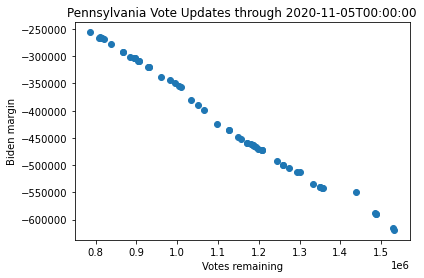

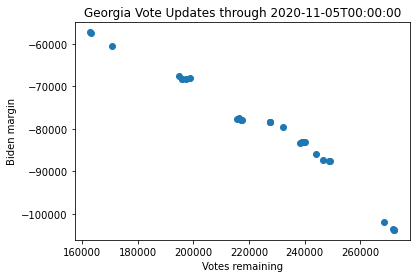

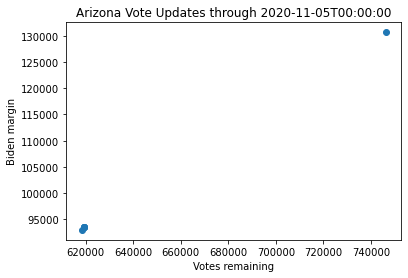

In [4]:
import matplotlib.pyplot as plt

state_list = ["Pennsylvania", "Georgia", "Arizona"]
timestamp_list = ["2020-11-05T00:00:00"]*3
iter_vals = list(zip(state_list, timestamp_list))

def plot_data(state, timestamp=None):
    "Plot the election data for a given state up through a given time"

    df = load_data(state, timestamp)

    plt.figure()
    plt.plot(df["votes_remaining"], df["vote_differential"], "o")
    plt.xlabel("Votes remaining")
    plt.ylabel("Biden margin")
    plt.title("{} Vote Updates through {}".format(state, timestamp))


for (state, tstamp) in iter_vals:
    plot_data(state, tstamp)

Note that the trend shows that Biden is catching up as more votes are
counted in both Georgia and Pennsylvania, while Trump is catching up
in Arizona.  The trend is fairly linear. Thus, one might first
consider doing a simple regression to estimate the final margin.

## Linear Regression Analysis

As a first pass at building a model, I can do a simple regression
analysis. A linear regression model will have two parameters that are
fit: the slope will be related to the fraction of the outstanding
votes that are for Biden, and the intercept, which will indicate the
final margin when there are no votes remaining. (This is the initial
analysis that was done by Camila for Pennsylvania and Martin for
Arizona.)

Predicted margin for Pennsylvania as of 2020-11-05T00:00:00: 139881.65460479335
Predicted margin for Georgia as of 2020-11-05T00:00:00: 11362.338299788926
Predicted margin for Arizona as of 2020-11-05T00:00:00: -87876.90143040325


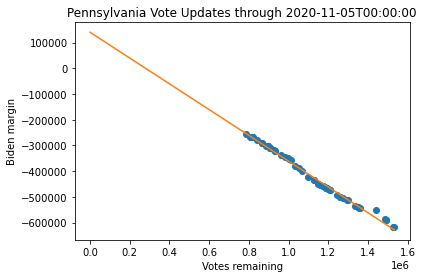

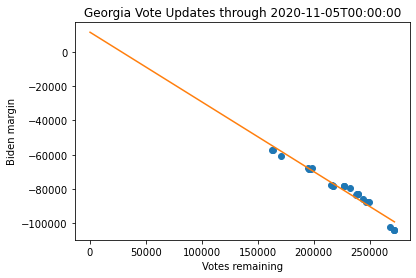

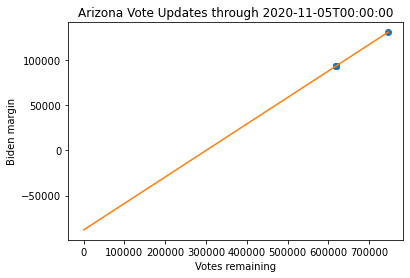

In [5]:
import numpy as np

def linear_regression(state, timestamp=None):
    """
    Fit a linear regression model to the election updates

    Fits a line to the data updates for a given state and a given
    timestamp. Plots the data and returns the fitting parameters
    (slope, intercept) as a numpy array.
    """

    plot_data(state, timestamp)

    df = load_data(state, timestamp)

    coeffs = np.polyfit(df["votes_remaining"], df["vote_differential"], 1)

    plotvals = np.linspace(0, df["votes_remaining"].iloc[-1])

    plt.plot(plotvals, coeffs[0]*plotvals + coeffs[1])

    return coeffs


for (state, tstamp) in iter_vals:
    coeffs = linear_regression(state, tstamp)
    print("Predicted margin for {} as of {}: {}".format(state, tstamp, coeffs[1]))

Note that at this point, the linear regression predicts a margin in
Pennsylvania and Arizona that are quite different from the final
margin.  Georgia appears to be very close to the final
margin. However, Arizona seems to have outlier points that muddles
this analysis (which was first noted by Martin). Thus, while these
models are useful starting points, they do not appear to be
particularly robust and are somewhat dependent on when you choose to
fit the data.

In [6]:
def get_margin(state, timestamp=None):
    "Extract margin for a state at a given time"
    
    df = load_data(state, timestamp)
    
    return df["vote_differential"].iloc[0]


for state in state_list:
    print("Current margin in {}: {}".format(state, get_margin(state)))

Current margin in Pennsylvania: 81660
Current margin in Georgia: 11779
Current margin in Arizona: 10457


However, one thing to note about this is that even though the trends
point clearly in favor of Biden in this analysis, we do not have a
good idea of the uncertainties.  Without an uncertainty, we cannot
robustly evaluate if the model is making good predictions.  How might
we develop a model that explicitly captures this uncertainty? And
given such a model, when can we be confident that a candidate has won
the state, and how does it align with the narrative from the news
media?  The following describes one approach for doing so.

## Modelling Uncertainty in the Votes

To address this shortcoming, we turn to Bayesian Inference. Bayesian
statisticians think of model parameters not as a single number, but
rather probability distributions -- in this way, we can get a sense of
the range of values that the model thinks are consistent with the
data.

### Model Structure

As noted above, the regression model has two different parameters: the
slope (related to the fraction of votes that are cast for Biden), and
the intercept (which is essentially the prediction of the final
margin). Note that while the linear regression fit these two things
simultaneously, there is no reason why I had to let the final margin
be a "free" parameter that was adjusted in the fitting: I could have
instead just fit a single parameter for the slope (for instance,
simply using the fraction of mail ballots cast thus far for one of the
candidates), and then used that estimate to project the votes
remaining in order to extrapolate and obtain an estimate of the final
margin.

We would like to adjust our model to account for uncertainty in both
of these pieces of the model. The main source of uncertainty in the
vote probability is related to the fact that not all voters are
identical -- the regression model assumes that this is the case, and
the main challenge in building a more complex model is to relax this
constraint while still ensuring that the model is simple enough that
we can reliably fit it with the available data. For this, I will
propose what is known as a *hierarchical* model, which is a common way
of adding more complexity to a model in Bayesian inference. However,
this is not the only way to do this, and there are certainly other
methods based on Bayesian inference that would be able to account for
this type of uncertainty.

There is also some uncertainty to account for in projecting the
remaining votes, but it turns out that this is much smaller than the
uncertainty in the vote probability. The way that I handle this type
of uncertainty is a fairly standard problem in Bayesian inference, so
I will focus most of my attention here on how to make a model that
does not treat all voters identically, as this is the principal source
of uncertainty. The following sections outline how to build such a
model, fit its parameters, and then project the election outcome once
it has been fit.

### Bayesian Model of the Vote Probability

Bayesian inference tends to think of probability distributions as
reflecting statements about our beliefs. Formally, I need to state my
initial beliefs before I see any data, and then I can use that data to
update my knowledge.  This previous belief is known as a *prior* in
Bayesian inference, and the updated beliefs once I look at the data is
known as the *posterior*.

#### Bayesian Inference

Bayesian inference involves taking our previous beliefs about a
system, described by a probability distribution of reasonable values
we expect a particular parameter to take, and then using the data to
update those beliefs about the distribution that we expect that
parameter to take by computing the *posterior*. A key concept in
Bayesian statistics is the idea of a conditional probability, written
$p(A|B)$, which means the probability of $A$ given that we already
know $B$ (or *conditioned on* $B$).  Inference allows us to update our
beliefs (or in other words condition them on something we have
observed) by applying Bayes' rule:

$$ p(\theta|y) = \frac{p(y|\theta)p(\theta)}{p(y)} $$

Here, $p(\theta)$ is the prior distribution (which we will specify
before looking at the data), $p(y|\theta)$ is the *likelihood* (the
probability that we would have gotten the data conditioned on a
particular value of $\theta$), and $p(y)$ is known as the *evidence*
(the probability of getting that particular observation over all
possible outcomes of the experiment).  Note that we have two standard
probability distributions (the prior and the evidence), and two
conditional probabilities (the likelihood and the posterior). The one
we really care about is the posterior (our belief in the model
parameters conditioned on the data, since the model parameters are
uncertain but the data is known), but in practice it is much easier to
compute the likelihood; Bayes' rule tells us how these two are
connected and makes these kind of computations more practical.

In practice, for most models one cannot compute the evidence very
easily, so instead of computing the posterior directly, one draws
samples from it.  A common technique for this is Markov Chain Monte
Carlo (MCMC) sampling.  A number of software libraries have been
written in recent years to make carrying out this sampling
straightforward using what are known as *probabilistic programming
languages*. These languages formally treat variables as probability
distributions with priors and then draw samples from the posterior to
allow the user to more easily perform inference.

Note that because I will ultimately draw samples from the posterior,
rather than compute the probability density function itself, most of
the plots in this story will not have meaningful vertical axis scales,
as the scale will depend on the number of samples that were
drawn. Thus in most cases I simply omit labels on the vertical axes,
as these are implicitly the number of samples in each case.

#### A Hierarchical Bayesian Model For Voting

In the linear regression model, we effectively treat the vote
probability as a single, unchanging value. This is the same as saying
that every voter in our model is identical. Given the political
polarization in the US, this is probably not a very good
assumption. Although the data seems to strongly suggest that the
mail-in votes are consistently in favor of one candidate, this is not
the same as saying all voters are identical. In the following, I build
a model to relax this assumption, using what is known as a
hierarchical Bayesian model.

If the above model of assuming that every voter is identical is one
extreme, then the other extreme is to assume that every voter is
different and we would need to estimate hundreds of thousands to
millions of parameters to fit our model. This is not exactly
practical, so a hierarchical model posits a middle ground that the
vote probability is itself drawn from a probability distribution.  In
this manner, we can use a probability distribution to describe the
overall population of voters, and thus rather than fitting a parameter
for every single voter, we just need to fit a few parameters to
specify the distribution.

This structure is why hierarchical models are so powerful: probability
distributions can be described with only a small number of parameters,
so they are easy to fit, but we will see that it vastly expands the
range of outcomes that the model is able to produce. This is in
essence why hierarchical models can be so powerful -- they guard
against overfitting by using only a few parameters, but they can still
produce a large variety of outcomes.

In the following, we model the vote probability by assuming that each
vote update has a single vote probability associated with it, and that
vote probability is drawn from a beta distribution. A beta
distribution is a distribution defined over the interval $[0,1]$ with
two shape parameters $a$ and $b$ that lets us flexibly specify a wide
range of outcomes. If $a$ and $b$ are less than 1, then the
distribution is biased towards the extreme values of 0 or 1, while if
they are greater than 1 then the distribution is biased towards
0.5. If $a > b$, then the model is more biased towards 1, while if $b
> a$ then the model is biased towards 0.  Thus we can specify a huge
range of distributions with just two parameters.

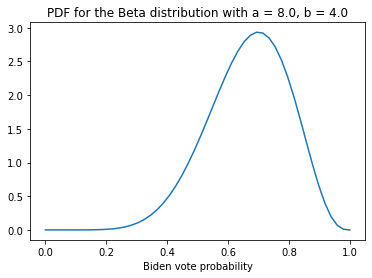

In [7]:
from scipy.stats import beta

def plot_beta(a, b):
    "Plot the beta distribution for shape paramters (a, b)"
    
    xvals = np.linspace(0, 1)

    plt.plot(xvals, beta.pdf(xvals, a=a, b=b))
    plt.xlabel("Biden vote probability")
    plt.title("PDF for the Beta distribution with a = {}, b = {}".format(a, b))


plot_beta(8., 4.)

Thus, instead of estimating the vote probability, I instead need to
estimate $a$ and $b$, which will tell us what I expect the
distribution of the vote probability to be. Having multiple levels
like this are what give hierarchical models their name -- parameters
are drawn from distributions whose parameters are also distributions
themselves.

Since all parameters in a Bayesian model must have priors, our task is
now to encode our prior beliefs about the vote probability
distribution by setting prior distributions for $a$ and $b$.

##### Prior

The prior represents our previous beliefs about the value of the model
parameters before we see any data, or in other words what we expect to
be reasonable. If you are observing outcomes from flipping a coin, you
might reasonably expect the probability of getting heads to be close
to 0.5 in the absence of any data, and you might be unwilling to
accept the idea of this probability of being 0 or 1. This is encoded
in a probability distribution function, usually by using a particular
distribution that is convenient given the constraints of the
particular problem (for instance, the beta distribution described
above is one that is often used to model priors where the parameter in
question is a probability).

Often, in Bayesian inference one does not have strong feelings about
what values they might expect for a parameter. In those cases, we
might prefer to use something simple, what is known as an
*uninformative* prior. These might be expressed as a statement like
"every value is equally probable". Or in this case we might assume
that the prior for the vote probability should be peaked close to 0.5,
and then taper off towards 0 and 1, with the argument that US
presidential elections are usually decided by a few percentage points
difference in the national popular vote. This might seem very
reasonable on the surface, as America is pretty evenly divided between
Democrats and Republicans.

However, mail in votes in practice can be extremely biased towards one
party. Historically, a large majority of mail in ballots are
Democratic, for a variety of reasons that are largely
demographic. Trump also spent much of the campaign sowing doubt about
mail-in ballots (telegraphing his post-election strategy of trying to
throw them out in court), so his supporters may be much less likely to
vote in this manner. However, there could also be a situation where
the mail-in ballots fall heavily towards a Republican candidate (as we
have seen already, more of the Arizona ballots tend to be in favor of
Trump, which was due to late arriving ballots being from Republicans
that registered to vote just before the election). Thus, based on this
I would argue that what we actually want is a prior that is reasonably
likely to include some extremes in the vote probability to ensure that
our estimate of the final outcome prior to looking at the data doesn't
exclude a significant swing.

This issue illustrates a challenge with Bayesian Hierarchical models
-- when the parameter that I have some knowledge about is itself
described by a distribution, the priors for the distribution
parameters can be more difficult to specify. For this reason,
modellers often go one level further and specify prior distributions
on the parameters used to specify the priors on the model parameters,
which are known as *hyperpriors*, and see how varying the priors
changes the outcome of inference. I will not explore this level of
Bayesian modelling, but in building this model I had to try a number of
different choices for the priors before arriving at something that I
thought accurately reflected my prior beliefs about the outcome.

In the priors that I finally settled on, I use a Lognormal
distribution for my prior on $a$ and $b$. Lognormal distributions are
frequently used as an alternative to a normal distribution in
situations when the parameter in question must be positive
(effectively, lognormal distributions can thought of as having the
logarithm of the random variable in question following a normal
distribution).  I choose the parameters of the lognormal distributions
for $a$ and $b$ to be slightly different such that the resulting
distributions are more likely to lean democratically (as mail in votes
are historically more democratic leaning), but still have a decent
chance of producing extremes for Trump. I also choose the parameters
such that I get a mix of values more biased towards the extremes as
well as those biased towards values closer to 0.5.

Priors like the ones used here are often referred to as *subjective*
priors.  Depending on who you ask, this is either a strength or a
weakness in Bayesian inference. On one hand, the results are somewhat
dependent on my parameter choices for my priors, but on the other
hand, nearly every scientific study reflects some of the biases of the
researchers that carry out the work. Subjective priors have the
benefit of explicitly codifying the assumptions I made about what I
expect to be reasonable outcomes, at the cost of some potential
subjectivity in the final results. In this era of significant divides
across party lines, exposing this part of the model as inherently
subjective may also help ensure that the model parameters are not
chosen in a way that explicitly favors one party over another.

As we will see, using this prior allows for the possibility that there
is a decent chance based on historical data that the mail votes are
heavily in favor of one candidate. The parameters I choose give a
slight edge to the candidate from the Democratic party, but the prior
includes a very reasonable chance that the swings will be towards the
Republican candidate, which should help ensure that the model is not
perceived to be biased against either candidate. Here are some
histograms showing single samples of the vote probability drawn from
this prior, and an aggregate histogram of 100 samples:

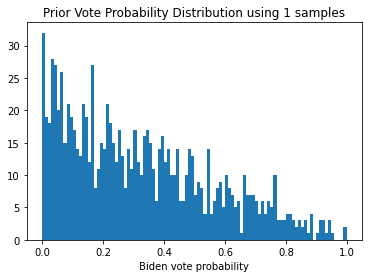

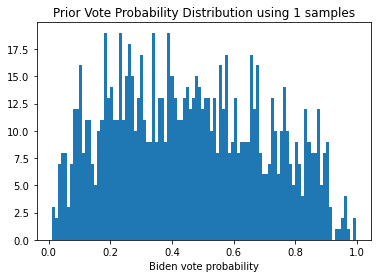

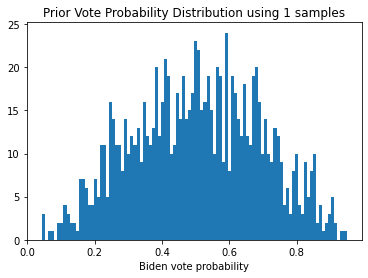

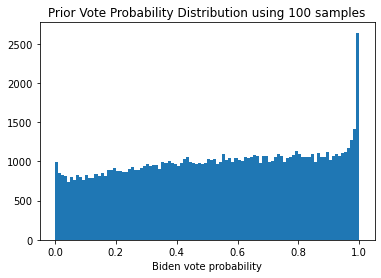

In [8]:
from pymc3 import Lognormal

def plot_prior_samples(n_samples):
    "Plot a random draw of the vote probability from the prior"

    a = Lognormal.dist(mu=0.4, sd=0.5).random(size=n_samples)
    b = Lognormal.dist(mu=0.2, sd=0.5).random(size=n_samples)

    x = np.linspace(0., 1.)
    
    plt.figure()
    plt.hist(beta.rvs(size=(1000, n_samples), a=a, b=b).flatten(), bins=100)
    plt.xlabel("Biden vote probability")
    plt.title("Prior Vote Probability Distribution using {} samples".format(i))


for i in [1, 1, 1, 100]:
    plot_prior_samples(i)

From these individual samples, as well as the aggregated histogram,
we see that we get a range of outcomes, with a slight bias
towards those that favor democrats. As we acquire enough data to reliably
estimate the underlying distribution of the vote probabilites, we should
see better estimates of the true distribution, which will eliminate
more of the extremes and reduce the uncertainty in the final outcome.

##### Likelihood

Finally, we need to explicitly model the likelihood. The likelihood is
how Bayesian models connect the parameters to the data -- the
likelihood tells us how probable the data is conditioned on a
particular choice of parameters. As discussed earlier, this is
actually the opposite of what we want, as we are interested in the
parameters conditioned on the data. However, Bayes' rule helps us
compute the quantity we are interested in as long as we are able to to
compute the likelihood.

For this particular problem, we can fortunately compute the likelihood
easily in closed form. When one flips a fair coin a number of times,
the distribution of outcomes follows a binomial distribution. Thus, I
can use a binomial likelihood to model the range of vote probabilites
that might be consistent with the votes that were cast. This can be
computed analytically, and most probabilistic programming languages
have built-in capacity for computing likelihoods of this type (so that
we don't have to worry about writing down the correct formula and
implementing and testing the code to do this ourselves!). This is done
automatically when using a probabilistic programming language by
setting this particular variable to have a known value, which
indicates to the probabilistic programming language that this variable
is used to compute the likelihood. This means that I can focus on
describing the model, rather than how to do the computation, which is
one of the strengths of this type of modelling.

##### PyMC3 Implementation

Thus, I can now write down a model in a probabilistic programming
language in order to draw samples from the posterior. There are a
number of popular lanaguages for this -- here I use PyMC3 to implement
my model. PyMC3 can easily handle all of the features I specified
above (hierarchical structure, and a binomial likelihood), which is
written out in the function below.

In coding up the model, I need to convert the election data into a
series of "trials" consisting of a number of total votes cast and the
corresponding number of votes for Biden. This is the way that the
information needs to be captured to compute the binomial likelihood,
which can then be used to draw samples from the posterior. Earlier, I
noted that the data sometimes contains some inconsistencies
(i.e. there are more votes cast for one candidate than the total
number in that batch), so to protect against this I perform some
checks for consistency and throw out any data that doesn't make sense
(in particular, I want to be sure the total number of votes is
non-negative and the number of votes cast for Biden is smaller than
the total number of ballots in this particular batch). I do this using
a Numpy logical array in the `extract_vote_trials` function, as
otherwise some inconsistent data can trip up the PyMC computations.

Once we have the trials defined, we can specify our model using PyMC3,
perform inference, and plot the results:

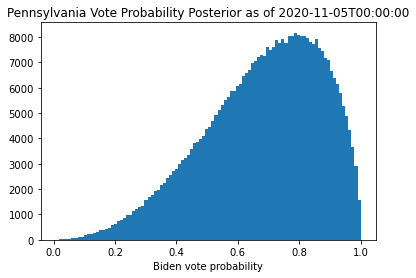

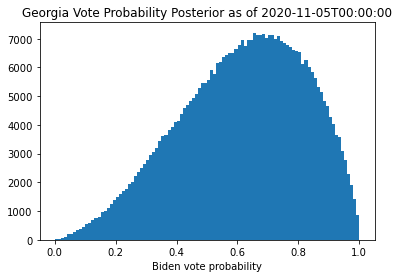

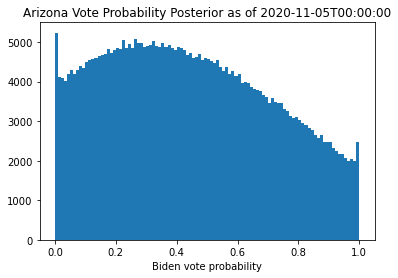

In [9]:
import pymc3

import logging
logger = logging.getLogger("pymc3")
logger.propagate = False
logger.setLevel(logging.ERROR)

def extract_vote_trials(state, timestamp=None):
    """
    Convert vote data into a series of bernoulli trials. If no
    data is valid (i.e. check that all numbers are nonzero and
    the number of total ballots cast is larger than the number
    of votes for, then return a list of a single zero for each.

    Returns two lists of positive integers for the total number
    of votes and the votes for Biden
    """

    df = load_data(state, timestamp)

    total_votes = np.diff(-df["biden_votes"]) + np.diff(-df["trump_votes"])
    biden_votes = np.diff(-df["biden_votes"])

    # throw out combinations that don't make any sense using numpy
    # logical arrays -- note that multiplication of logical arrays
    # is equivalent to a logical "and";
    # if none remain then just return (0,0)

    trials_to_keep = ((total_votes > 0)*(biden_votes >= 0)*
                      (biden_votes <= total_votes))
    total_votes = total_votes[trials_to_keep]
    biden_votes = biden_votes[trials_to_keep]

    if len(total_votes) == 0:
       total_votes = [0]
       biden_votes = [0]

    return (np.array(total_votes, dtype=np.int64),
            np.array(biden_votes, dtype=np.int64))


def estimate_theta_hierarchical(state, timestamp=None):
    "Estimate the vote probability distribution using a hierarchical model and MCMC sampling"

    total_votes, biden_votes = extract_vote_trials(state, timestamp)
    num_trials = len(total_votes)

    # build model and draw MCMC samples

    with pymc3.Model() as model:
        a = pymc3.Lognormal("a", mu=0.4, sd=0.5)
        b = pymc3.Lognormal("b", mu=0.2, sd=0.5)
        theta = pymc3.Beta("theta", alpha=a, beta=b, shape=num_trials) 
        obs = pymc3.Binomial("obs", p=theta, n=total_votes,
                             observed=biden_votes, shape=num_trials)
        trace = pymc3.sample(1000, progressbar=False,
                             return_inferencedata=False)

    return trace


def plot_posterior(state, timestamp):
    "Plot the posterior distribution of the vote probability"

    trace = estimate_theta_hierarchical(state, timestamp)

    rvs_size = (100, len(trace["a"]))
    
    plt.figure()
    plt.hist(beta.rvs(size=rvs_size,
                      a=np.broadcast_to(trace["a"], rvs_size),
                      b=np.broadcast_to(trace["b"], rvs_size)).flatten(),
                      bins=100)
    plt.xlabel("Biden vote probability")
    plt.title("{} Vote Probability Posterior as of {}".format(state, timestamp))


for (state, tstamp) in iter_vals:
    plot_posterior(state, tstamp)

Once I draw MCMC samples for $a$ and $b$, I convert those samples into
samples of $\theta$ to see our posterior estimate of the vote
probability.

Looking at these plots, I see that the model is now much more varied
in its estimates for the vote probability (note that this is the
posterior for the *distribution* expected for the vote probability,
rather than the explicit values of the vote probability itself). The
mean is still where I expect it based on the linear regression
analysis, but the distribution is much wider due the fact that
occasionally votes come in from places that are not as heavily in
favor of Biden (or Trump in the case of Arizona). This wider
distribution of the vote probability is how I quantify the larger
uncertainty in the election outcome. Using this distribution to
forecast the remaining votes should considerably increase the spread
of the predicted final margin and assure that it is not overconfident
in the final result.

### Predicting the Final Margin

Once I have samples from the vote probability, I need to simulate the
remaining votes to predict the final outcome. This is known as
estimating the *posterior predictive distribution* in Bayesian
inference, when one uses the updated knowledge about one of the model
parameters to predict something that was not used to fit the data.

What is a reasonable way to simulate the remaining votes? As one can
see from the data, the votes come in a steady drip feed as ballots are
counted. Thus, I can simulate this by sampling randomly, with
replacement, from the data for the number of ballots cast in each
update until I get to the number of votes remaining. I can then use
the posterior samples of $a$ and $b$ to generate a distribution of
vote probabilities, and then draw from the vote probabilites to
forecast the outcome of each batch of votes using a binomial
distribution. I repeat this process 10 times to ensure that the result
isn't dependent on the particular realization of the drip feed
simulation, and aggregate those samples to get the final estimate of
the posterior predictive distribution. This should give a reasonable
estimate of the final outcome based on the model.

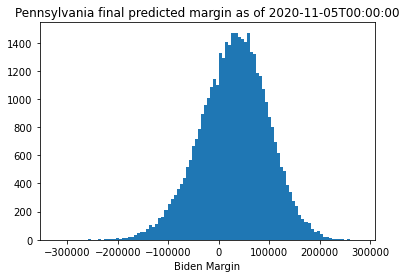

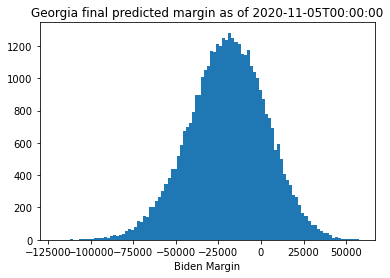

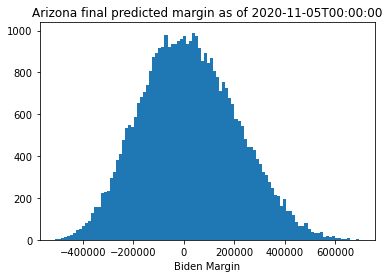

In [10]:
from scipy.stats import binom

def get_votes_remaining(state, timestamp=None):
    "Extract remaining votes for a state at a given timestamp"
    
    df = load_data(state, timestamp)

    return df["votes_remaining"].iloc[0]


def draw_random_vote_updates(state, timestamp):
    "Draw a random set of simulated vote updates for the remaining votes"

    n_remain = get_votes_remaining(state, timestamp)

    n, k = extract_vote_trials(state, timestamp)
    
    if np.all(n == 0):
        n = np.array([1000], dtype=np.int64)

    simulated_vote_updates = []
        
    while np.sum(simulated_vote_updates) <= n_remain:
        simulated_vote_updates.append(np.random.choice(n))
            
    simulated_vote_updates[-1] = n_remain - np.sum(simulated_vote_updates[:-1])
    assert np.sum(simulated_vote_updates) == n_remain
    
    return np.array(simulated_vote_updates, dtype=np.int64)


def project_remaining_votes(trace, simulated_vote_updates):
    "Project the remaining votes using MCMC samples of the vote probability distribution parameters"

    rvs_size = (len(trace["a"]), len(simulated_vote_updates))
    
    return np.sum(binom.rvs(size=rvs_size,
                            p=beta.rvs(size=rvs_size,
                                       a=np.broadcast_to(trace["a"][:, np.newaxis], rvs_size),
                                       b=np.broadcast_to(trace["b"][:, np.newaxis], rvs_size)),
                            n=np.broadcast_to(simulated_vote_updates, rvs_size)), axis=-1)


def predict_final_margin(trace, state, timestamp=None):
    """
    Use posterior samples of the vote probability to predict the remaining
    votes.

    The remaining votes are split into batches by sampling from
    the previous votes until enough are accumulated. Then each batch is
    forecast using the posterior samples, and the total is summed.

    Returns a numpy array of samples of the final margin
    """

    assert np.all(trace["a"] >= 0.)
    assert np.all(trace["b"] >= 0.)

    # simulate remaining votes

    n_trials = 10

    predicted_margin = np.zeros((n_trials, len(trace["a"])))

    for i in range(n_trials):

        simulated_vote_updates = draw_random_vote_updates(state, timestamp)
    
        predicted_margin[i] = project_remaining_votes(trace, simulated_vote_updates)

    n_remain = get_votes_remaining(state, timestamp)
    margin = get_margin(state, timestamp)

    return margin - n_remain + 2*predicted_margin.flatten()


def plot_predictions(state, timestamp):
    "Plot the posterior predictive distribution for the given state and time"

    trace = estimate_theta_hierarchical(state, timestamp)
    predicted_margin = predict_final_margin(trace, state, timestamp)
    
    plt.figure()
    plt.hist(predicted_margin, bins=100)
    plt.xlabel("Biden Margin")
    plt.title("{} final predicted margin as of {}".format(state, timestamp))
    
for (state, tstamp) in iter_vals:
    plot_predictions(state, tstamp)

As we can see from this, the model has fairly wide intervals
surrounding the predicted final margin based on the original linear
regression model.  Interestingly, when I fit Georgia in this way, it
looks much more likely that Trump would win through this point than
the linear regression model would suggest, though the final margin
found by the regression analysis is well within the error bounds
suggested from the predictions. Arizona looks up for grabs, indicating
that the outlier points were definitely biasing the regression
analysis. Pennsylvania is much more firmly leaning towards Biden. We
can look at the results again a day later to see how the race evolved:

There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


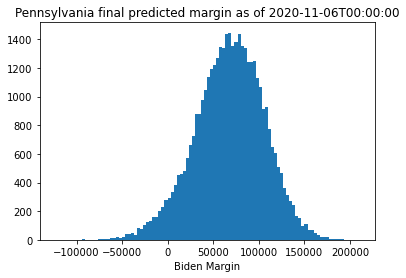

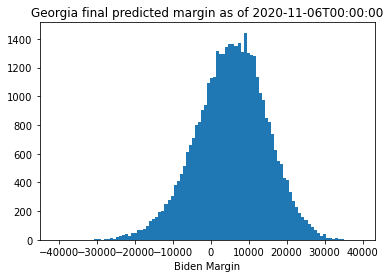

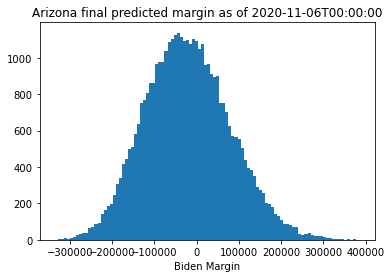

In [11]:
for (state, tstamp) in zip(state_list, ["2020-11-06T00:00:00"]*3):
    plot_predictions(state, tstamp)

Clearly, Georgia has swung in Biden's favor over the course of the day.
The mean final margin in Pennsylvania has not moved much, though the
uncertainty has tightened up and made the result more likely for Biden.
Arizona could still go either way.

## Animating the Updates

Now that I have built a model, I can build an animation that shows the
evolution of the predicted results as a function of time. This will
show how the uncertainty shrinks over time as fewer votes remain. I
check for results every 30 minutes for the 12 days from 4 November
onward, and update the model when new ballots are found. I also
compute a Biden win probability and show the mean margin $\pm$ 2
standard deviations to give an idea of the equivalent regression
result and its uncertainty.  Building the animation requires some more
clever manipulation of Matplotlib objects, so I will not go into
detail to describe exactly what the plotting code is doing here. It is
based on the code in this
[example](https://matplotlib.org/stable/gallery/animation/animated_histogram.html),
so please look at that example for a description of how to animate
histograms.

**Note:** Because new MCMC samples need to be drawn for each new update,
creating this animation ends up being fairly expensive to run (this took
several hours on my laptop). I speed things up by saving the current
prediction each time the MCMC samples are drawn, so that if the previous
iteration is the same we do not need to re-run the model. However, this
is still fairly expensive, so don't try and run this unless you are willing
to wait!

In [12]:
%%capture

import matplotlib.path as path
import matplotlib.patches as patches
import matplotlib.text as text
import matplotlib.animation as animation

def load_previous_model(filename, initialize=False):
    """
    Load the previous model from file

    Load results from the previous simulation from disk,
    including the total votes cast, votes for Biden,
    number of votes remaining, and the previous set of
    samples from the predictive distribution.
    If the file cannot be loaded, or if we pass
    `initialize=True`, returns `None` for all values.
    """

    total_votes = None
    biden_votes = None
    n_remain = None
    preds = None
    
    if not initialize:
        try:
            model = np.load(filename)
            total_votes = model["total_votes"]
            biden_votes = model["biden_votes"]
            n_remain = int(model["n_remain"])
            preds = model["preds"]
        except (KeyError, IOError):
            total_votes = None
            biden_votes = None
            n_remain = None
            preds = None

    return total_votes, biden_votes, n_remain, preds


def fit_model(state, timestamp=None, initialize=False):
    """
    Fit a model to predict the final margin for the given date/time.
    Each iteration is saved as a numpy file, and the next step
    checks for a model that matches the existing vote count before
    doing the expensive MCMC fitting

    Returns the simulated final margin samples at the given time
    """

    filename = "model.npz"

    total_votes_prev, biden_votes_prev, n_remain_prev, preds_prev = \
        load_previous_model(filename, initialize)

    total_votes, biden_votes = extract_vote_trials(state, timestamp)

    n_remain = get_votes_remaining(state, timestamp)
    
    if (np.array_equal(total_votes_prev, total_votes) and
        np.array_equal(biden_votes_prev, biden_votes) and
        n_remain_prev == n_remain):
        return preds_prev
    else:
        theta = estimate_theta_hierarchical(state, timestamp)
        preds =  predict_final_margin(theta, state, timestamp)
        np.savez(filename,
                 total_votes=total_votes, biden_votes=biden_votes,
                 preds=preds, n_remain=n_remain)
        return preds


def initialize_verts(bins):
    "Initialize the patch corners for the animation"

    # get the corners of the rectangles for the histogram
    left = bins[:-1]
    right = bins[1:]
    vals = np.zeros(len(left))
    nrects = len(left)

    nverts = nrects * (1 + 3 + 1)
    verts = np.zeros((nverts, 2))
    codes = np.full(nverts, path.Path.LINETO)
    codes[0::5] = path.Path.MOVETO
    codes[4::5] = path.Path.CLOSEPOLY
    verts[0::5, 0] = left
    verts[0::5, 1] = vals
    verts[1::5, 0] = left
    verts[1::5, 1] = vals
    verts[2::5, 0] = right
    verts[2::5, 1] = vals
    verts[3::5, 0] = right
    verts[3::5, 1] = vals

    return verts, codes


def update_verts(preds, bins, verts):
    "Update the verticies on the histogram patches for animation"

    n, bins = np.histogram(preds, bins)
    verts[1::5, 1] = n
    verts[2::5, 1] = n

    return verts


def animate(i, state, start_time, bins_t, verts_t, patch_t, bins_b, verts_b, patch_b,
            date_text, vote_text, mean_text, prob_text):
    "Updates the histogram patches and text to make the animated histogram plot"
        
    hours = i//2
    minutes = 30*i % 60
        
    timestamp = ((datetime.datetime.strptime(start_time, "%Y-%m-%dT%H:%M:%S") +
                  datetime.timedelta(hours=hours, minutes=minutes)).strftime("%Y-%m-%dT%H:%M:%S"))

    if i == 0:
        preds = fit_model(state, timestamp, initialize=True)
    else:
        preds = fit_model(state, timestamp)

    verts_t = update_verts(preds, bins_t, verts_t)
    verts_b = update_verts(preds, bins_b, verts_b)

    date_text.set_text(datetime.datetime.strptime(timestamp, "%Y-%m-%dT%H:%M:%S").strftime("%Y-%m-%d %H:%M"))

    n_remain = get_votes_remaining(state, timestamp)
    vote_text.set_text("{} Votes Remaining".format(str(n_remain)))

    mean_text.set_text("Margin = {:>8} $\pm$ {:>7}".format(int(np.mean(preds)),
                                                           int(2.*np.std(preds))))

    prob_text.set_text("Biden win prob = {:.2f}".format(np.sum(preds > 0)/len(preds)))
        
    return [patch_t, patch_b, date_text, vote_text, mean_text, prob_text]


def create_animation(state):
    "Create an animation of the vote updates for the given state"

    start_time = "2020-11-04T14:00:00"
    
    xlim = 100000
    ylim = 500
    nbins = 200
    binsize = xlim//nbins

    bins_b = np.linspace(0, xlim, binsize, dtype=np.int64)
    bins_t = np.linspace(-xlim, 0, binsize, dtype=np.int64)
    
    verts_t, codes_t = initialize_verts(bins_t)
    verts_b, codes_b = initialize_verts(bins_b)

    patch_t = None
    patch_b = None

    fig, ax = plt.subplots()
    barpath_t = path.Path(verts_t, codes_t)
    patch_t = patches.PathPatch(barpath_t, facecolor='C3',
                                edgecolor='C3', alpha=0.5)
    ax.add_patch(patch_t)
    barpath_b = path.Path(verts_b, codes_b)
    patch_b = patches.PathPatch(barpath_b, facecolor='C0',
                                edgecolor='C0', alpha=0.5)
    ax.add_patch(patch_b)

    lefttext = -9*xlim//10
    righttext = 9*xlim//10
    uppertext = 9*ylim//10
    lowertext = 8*ylim//10

    date_text = text.Text(lefttext, uppertext, "")
    ax.add_artist(date_text)

    vote_text = text.Text(lefttext, lowertext, "")
    ax.add_artist(vote_text)

    prob_text = text.Text(righttext, uppertext, "", ha='right')
    ax.add_artist(prob_text)

    mean_text = text.Text(righttext, lowertext, "", ha='right')
    ax.add_artist(mean_text)

    ax.set_xlim(-xlim, xlim)
    ax.set_ylim(0, ylim)
    ax.set_xlabel("Biden margin")
    ax.set_title("{} Final Margin Prediction".format(state))
    
    ani = animation.FuncAnimation(fig, animate, frames=2*24*12, interval=200,
                                  fargs=(state, start_time,
                                         bins_t, verts_t, patch_t,
                                         bins_b, verts_b, patch_b,
                                         date_text, vote_text, mean_text, prob_text),
                                  repeat=False, blit=True)
    
    return ani


ani_pa = create_animation("Pennsylvania")
ani_ga = create_animation("Georgia")
ani_az = create_animation("Arizona")

There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


Displaying these, we can see how the race evolves over time.

In [13]:
from IPython.display import HTML

HTML(ani_pa.to_jshtml())

There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


In [14]:
HTML(ani_ga.to_jshtml())

There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


In [16]:
HTML(ani_az.to_jshtml())

Based on this model, we can see that Pennsylvania was very clearly going
in Biden's direction from early on, despite Trump's substantial lead at the
end of Election Day. This was reflected by comments made by other election
data journalists, all of whom were fairly confident that the numbers were
good news for Biden even as early as 4 November. Biden's win probability
steadily increased, surpassing 99% on 6 November. The media called
the state, and the election, for Biden on 7 November.

Georgia, on the other hand, was not a sure thing. For much of the early data,
our model favored Trump, who had a win probability of 82% on the evening of
4 November. However, the uncertainties were wide enough at that point that
Biden's eventual victory was still not an unreasonable outcome. As the
ballots shifted towards Biden, we can see a clear change on 5 November,
and by that evening Biden's win probability was 70%. Biden's chances
steadily increased and surpassed 99% on the evening of 7 November. However,
since the final margin was still fairly small in absolute terms, the media
did not call Georgia until 12 or 13 November.

Arizona, despite being the first state among these that many news outlets
called, showed the largest uncertainties for much of the time period we
have data, with no candidate having a clear advantage until 9 November when
Biden took a slight lead in the model predictions. From there, Biden inched
ahead as the remaining ballots came in, and the outcome shifted clearly in
his favor on 12 November with his win probability exceeding 99% that evening.
The remaining media outlets called Arizona for Biden on 13 November.

As we can see, our model is able to call the outcome of these states slightly
before the media does so (possibly due to some level of conservatism).
Seeing the range of uncertainties shrink is helpful to know what range of
outcomes could still be reasonably expected, and can be a much more interesting
way to visualize the results (particularly when animated as above).

## Conclusion

This Data Story examined how we could build a Bayesian hierarchical
model for the US election data and use it to forecast the final
outcome.  The model showed how the outcome in three key battleground
states evolved over the week following the election as mail ballots
were counted, tipping the election in favor of Biden. Because the
model includes uncertainties and prior beliefs about voting behavior,
this gave a richer picture of how to forecast the final result than
simply extrapolating using early returns (with considerable more
thought and effort required, however!). Because of the time scales
over which the election played out, we could imagine having put this
in place to make prospective predictions (stay tuned for 2024!) in
real time to see how this simple model aligns with more experienced
election forecasters.